In [4]:
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("white")
import pandas
from pathlib import Path

from skimage.filters import threshold_otsu
import scipy.ndimage as ndi


In [5]:

test_set_predictions_path = Path("results") / "20240519_1457_baseline-b8-e100-w211-aug-xyz-d02-lr1e-4_fold0" / "test_set_predictions"
# test_set_predictions_path = Path("results") / "old"
test_set_images_path = Path("dataset") / "test_set" / "images"
raw_segmentations_path = test_set_predictions_path.parent / "raw_segmentations.npy"

predictions = pandas.read_csv(test_set_predictions_path / "predictions.csv")

def keep_central_connected_component(prediction: np.ndarray) -> np.ndarray:
    """Post-process a segmentation to keep only the most connected component."""
    labels, n_components = ndi.label(prediction)

    patch_size = np.array([64,128,128])
    center = (patch_size - 1) / 2

    # Pre-calculate a matrix of Euclidean distances to the center
    xx, yy, zz = np.meshgrid(np.arange(patch_size[0]), np.arange(patch_size[1]), np.arange(patch_size[2]), indexing='ij')
    distance_grid = np.sqrt((xx - center[0])**2 + (yy - center[1])**2 + (zz - center[2])**2)

    # Get the minimum distance to the center for each connected component.
    distances = np.array([
        distance_grid[labels == (i+1)].min() for i in range(n_components)
    ])

    if len(distances) > 0:
        central_component_index = np.argmin(distances)
        prediction = (labels == (central_component_index + 1)).astype(np.uint8)

    return prediction

/var/folders/lv/v4gw9_s94gl2_mr0pt1vfhx40000gn/T/ipykernel_15215/923862385.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(5 if raw_segmentation is not None else 2, 3, figsize=(10, 8), constrained_layout=True)


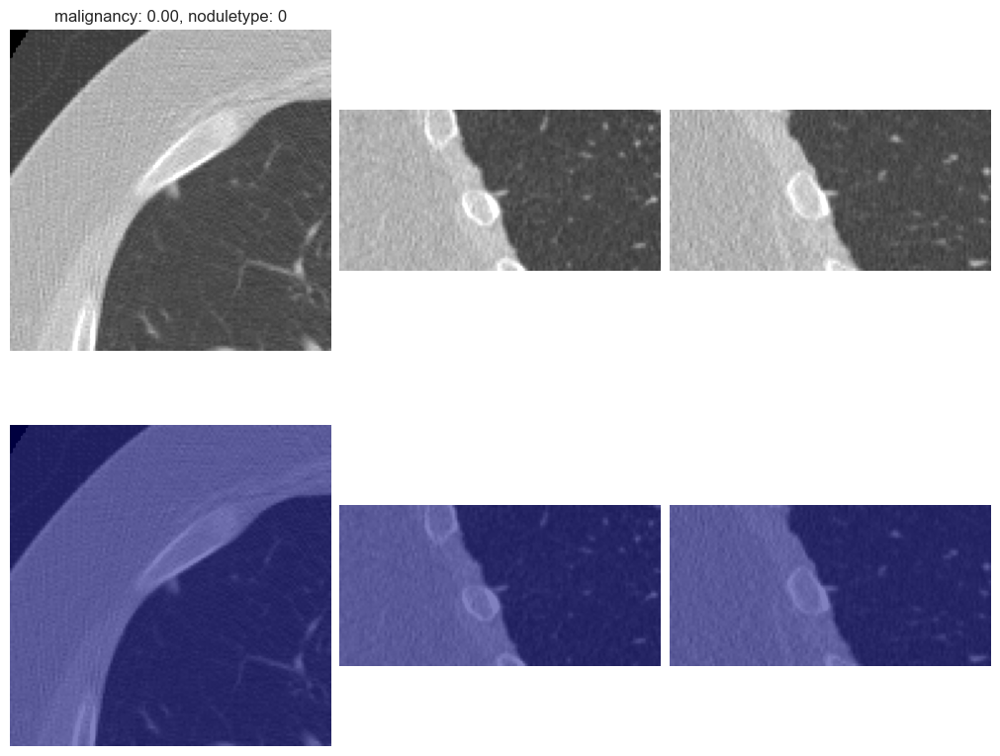

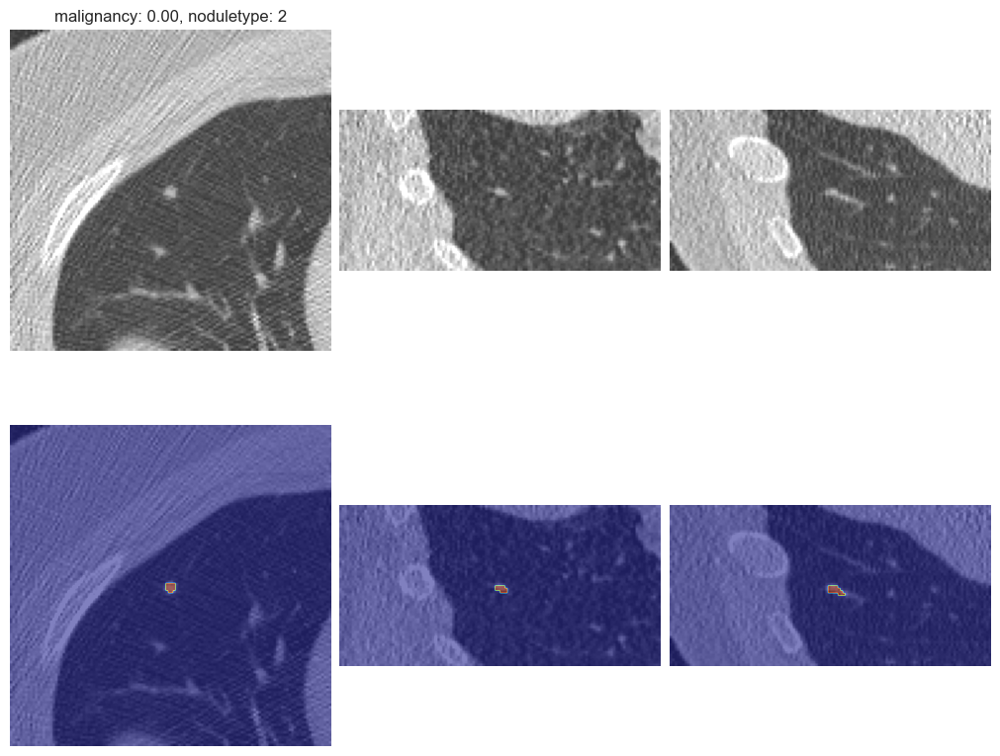

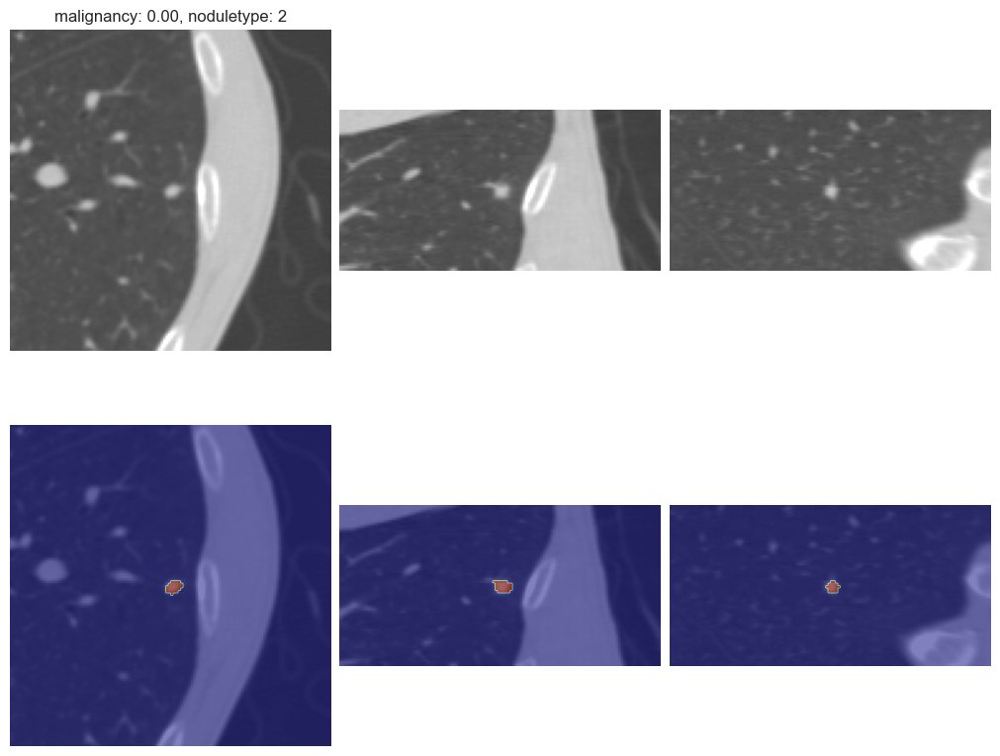

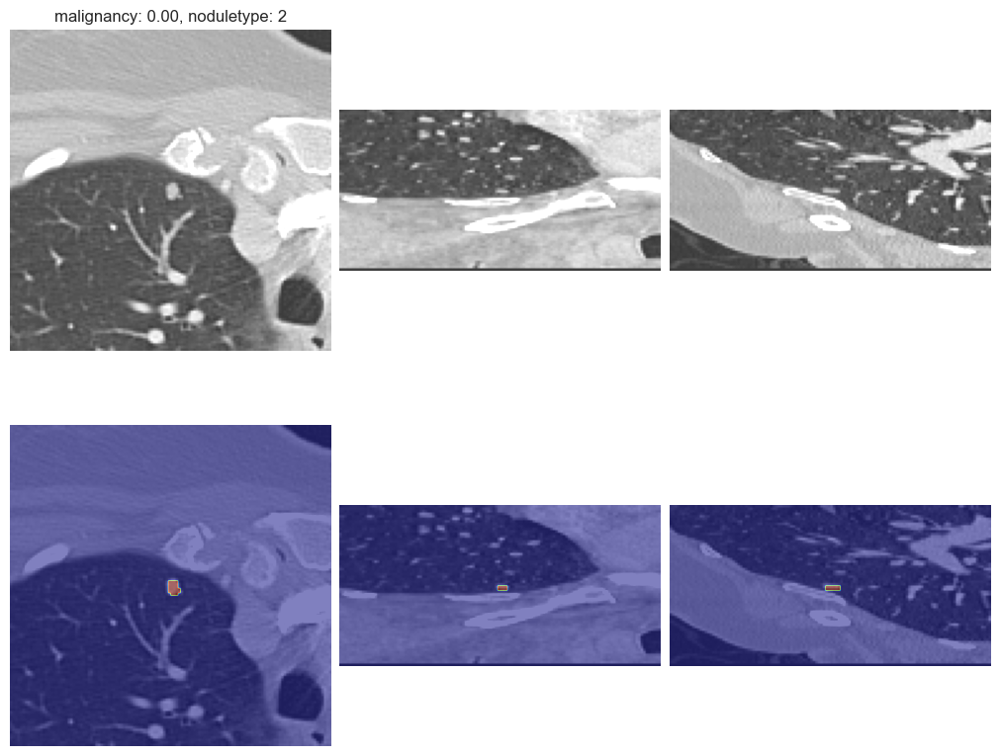

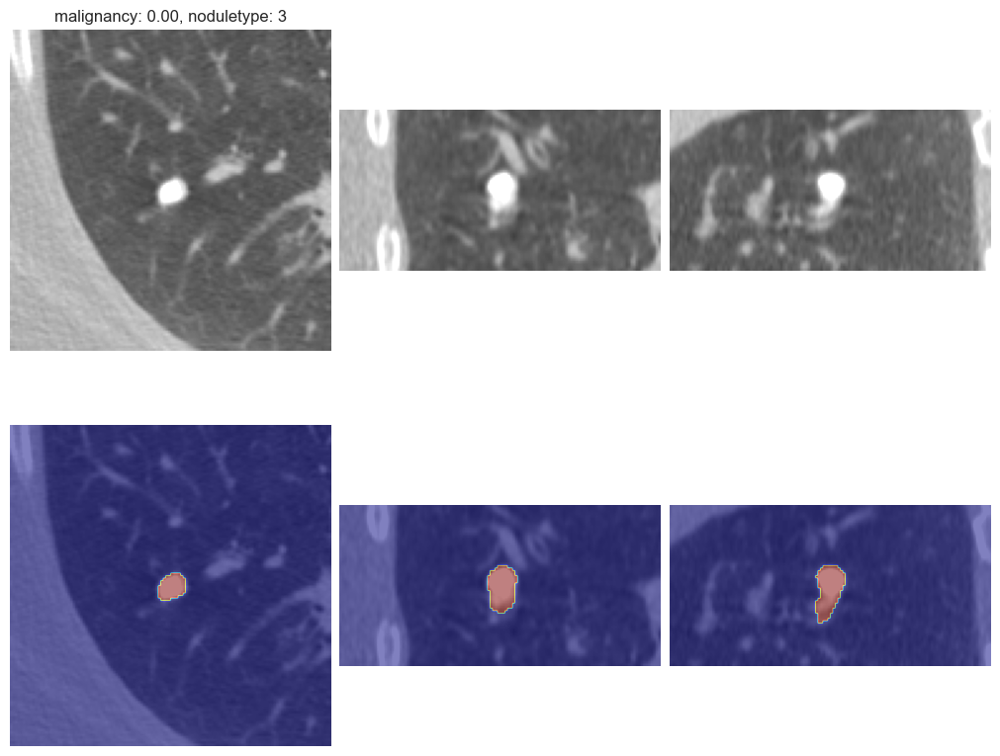

...

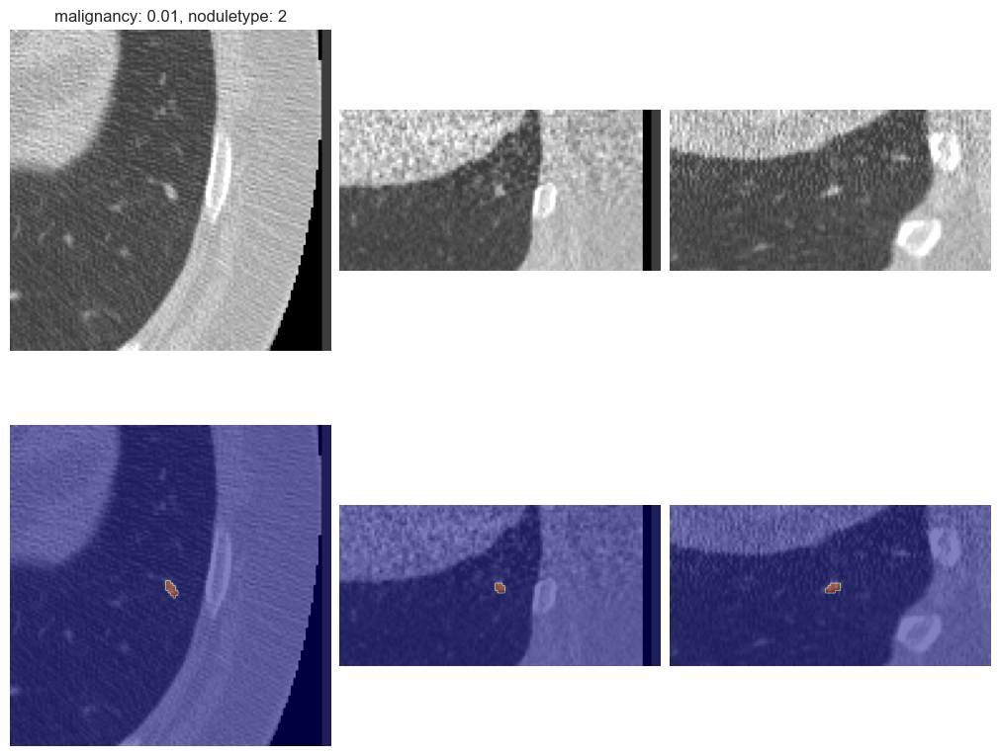

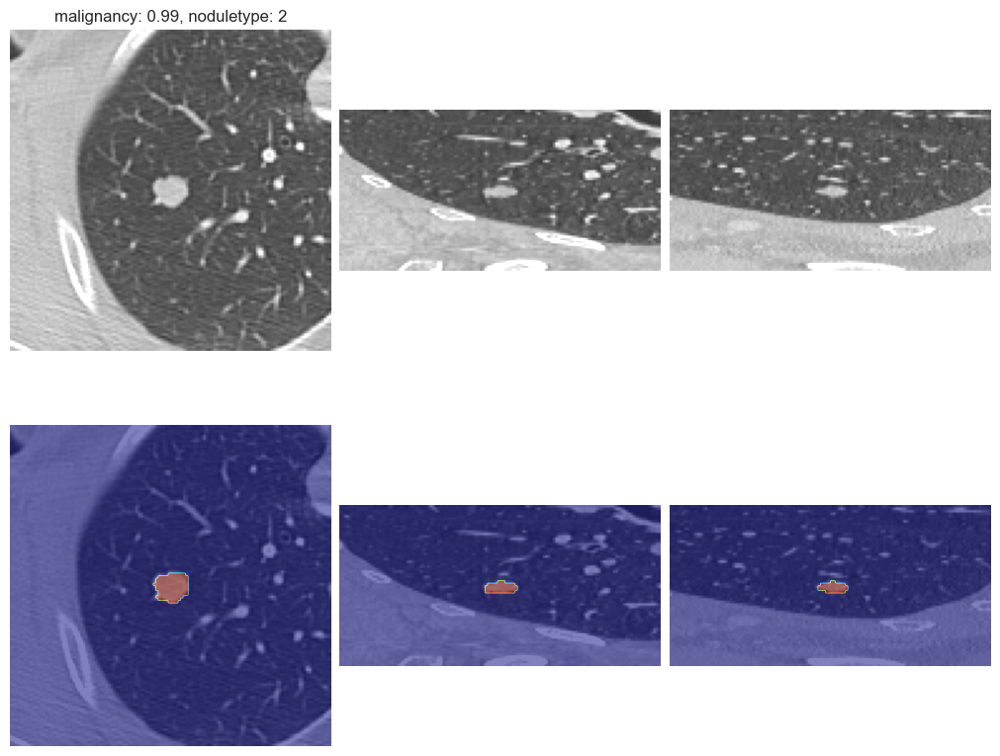

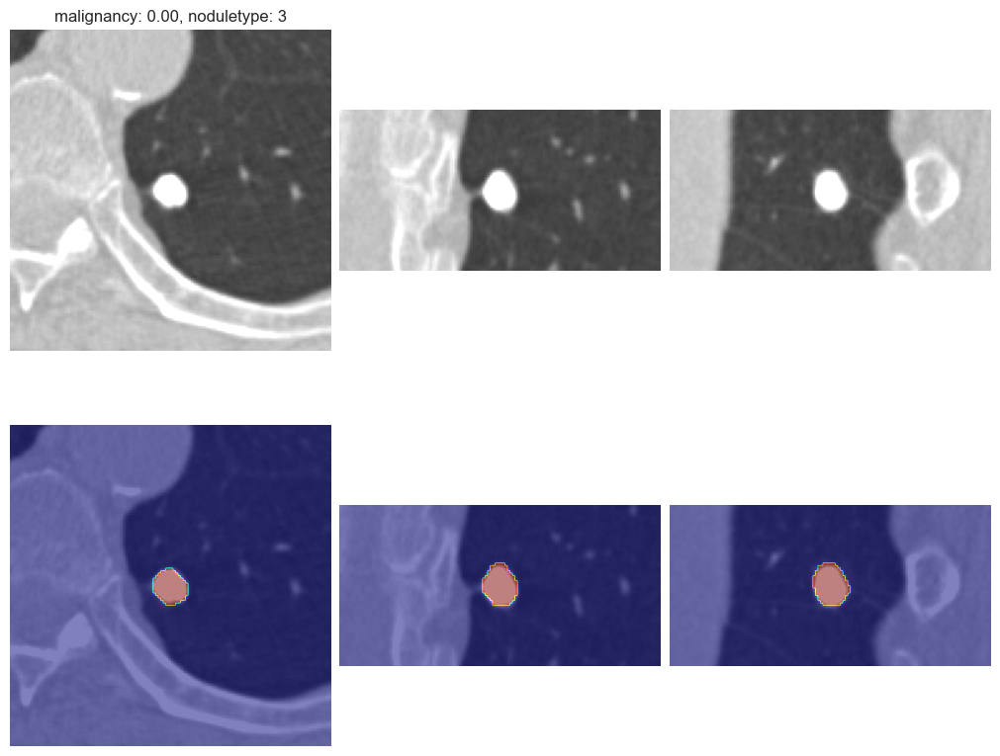

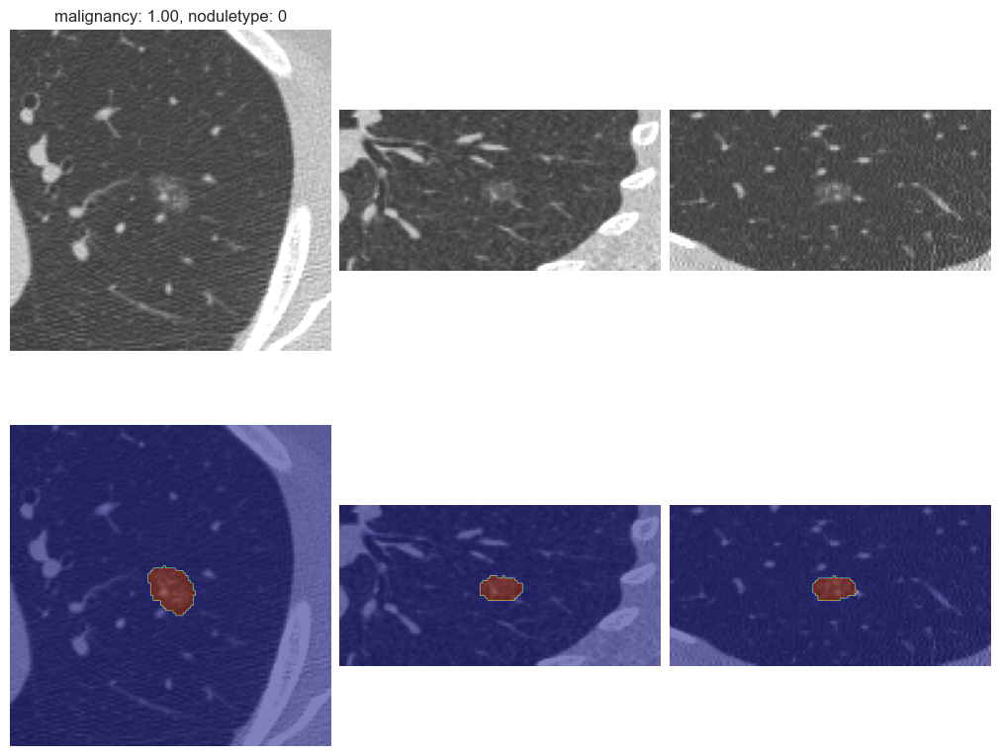

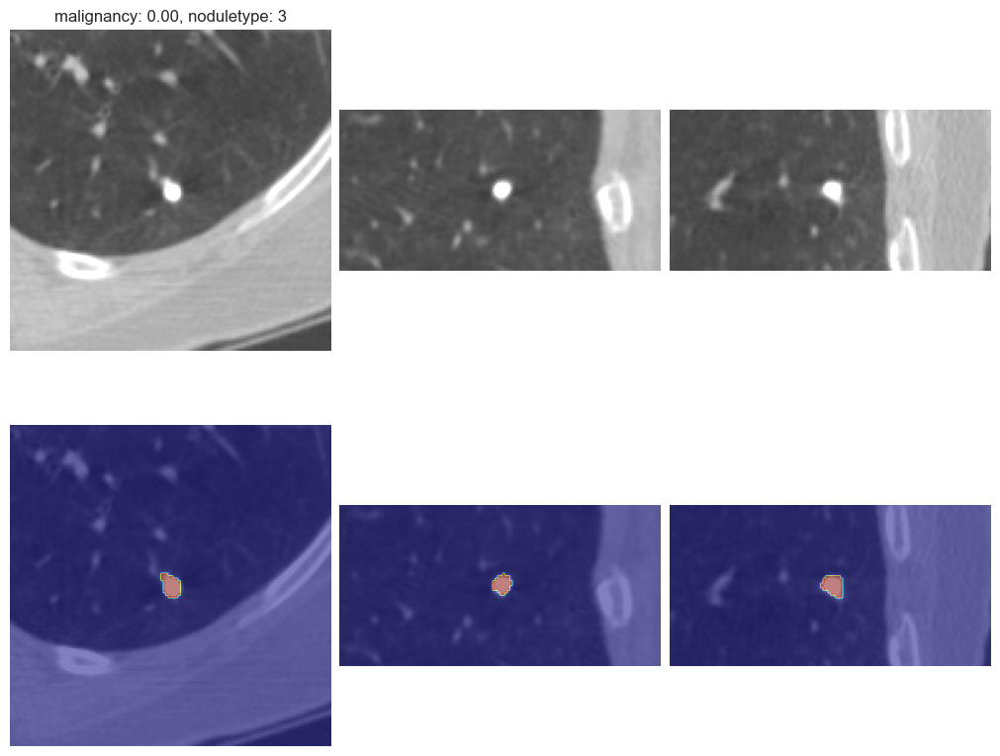

In [6]:
raw_segmentations = []
# if raw_segmentations_path.exists():
#     raw_segmentations = list(np.load(raw_segmentations_path))

for idx, image_path in enumerate(sorted(list(test_set_images_path.glob("*.mha")))):
    noduleid = image_path.stem
    raw_segmentation = raw_segmentations[idx] if raw_segmentations else None

    pd = predictions[predictions.noduleid == noduleid].iloc[0]

    image = sitk.GetArrayFromImage(sitk.ReadImage(str(image_path)))
    segmentation = sitk.GetArrayFromImage(sitk.ReadImage(str(test_set_predictions_path / "segmentations" / f"{noduleid}.mha")))

    fig, ax = plt.subplots(5 if raw_segmentation is not None else 2, 3, figsize=(10, 8), constrained_layout=True)

    ax[0,0].set_title(f"malignancy: {pd.malignancy:.2f}, noduletype: {pd.noduletype}")
    ax[0,0].imshow(image[32], vmin=-1500, vmax=500, cmap="gray")
    ax[0,1].imshow(image[:,64], vmin=-1500, vmax=500, cmap="gray")
    ax[0,2].imshow(image[:,:,64], vmin=-1500, vmax=500, cmap="gray")
    ax[1,0].imshow(image[32], vmin=-1500, vmax=500, cmap="gray")
    ax[1,0].imshow(segmentation[32], vmin=0, vmax=1, cmap="jet", alpha=0.5)
    ax[1,1].imshow(image[:,64], vmin=-1500, vmax=500, cmap="gray")
    ax[1,1].imshow(segmentation[:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)
    ax[1,2].imshow(image[:,:,64], vmin=-1500, vmax=500, cmap="gray")
    ax[1,2].imshow(segmentation[:,:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)

    if raw_segmentation is not None:
        ax[2,0].imshow(image[32], vmin=-1500, vmax=500, cmap="gray")
        ax[2,0].imshow(raw_segmentation[32], vmin=0, vmax=1, cmap="jet", alpha=0.5)
        ax[2,1].imshow(image[:,64], vmin=-1500, vmax=500, cmap="gray")
        ax[2,1].imshow(raw_segmentation[:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)
        ax[2,2].imshow(image[:,:,64], vmin=-1500, vmax=500, cmap="gray")
        ax[2,2].imshow(raw_segmentation[:,:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)

        threshold_value = threshold_otsu(raw_segmentation)
        # threshold_value = 0.1
        thresholded = raw_segmentation > threshold_value
        ax[3,0].imshow(image[32], vmin=-1500, vmax=500, cmap="gray")
        ax[3,0].imshow(thresholded[32], vmin=0, vmax=1, cmap="jet", alpha=0.5)
        ax[3,1].imshow(image[:,64], vmin=-1500, vmax=500, cmap="gray")
        ax[3,1].imshow(thresholded[:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)
        ax[3,2].imshow(image[:,:,64], vmin=-1500, vmax=500, cmap="gray")
        ax[3,2].imshow(thresholded[:,:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)


        output = keep_central_connected_component(thresholded)

        ax[4,0].imshow(image[32], vmin=-1500, vmax=500, cmap="gray")
        ax[4,0].imshow(output[32], vmin=0, vmax=1, cmap="jet", alpha=0.5)
        ax[4,1].imshow(image[:,64], vmin=-1500, vmax=500, cmap="gray")
        ax[4,1].imshow(output[:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)
        ax[4,2].imshow(image[:,:,64], vmin=-1500, vmax=500, cmap="gray")
        ax[4,2].imshow(output[:,:,64], vmin=0, vmax=1, cmap="jet", alpha=0.5)

        plt.show()
        plt.hist(raw_segmentation.flatten(), bins=100, log=True)
        plt.vlines(threshold_value, 0, 1e6, color="red")
        plt.show()

    [a.axis("off") for a in ax.flatten()]

    # optionally: save these figures to disk and don't plot inline

    if idx > 60: 
        break